In [1]:
import numpy as np
import pandas as pd
from puzzle import *
from utils import *
import matplotlib.pyplot as plt

In [2]:
def solve(state, criteria):
    init_state = State(np.array(state))
    puzzle = Puzzle(init_state, criteria)
    return puzzle.solve()

data = []
for state_name, start_state in start_states.items():
    for criteria_name, criteria in criterium.items():
        print(f'state: {state_name}, criteria: {criteria_name}')
        data_dict = solve(start_state, criteria)
        data_dict['state'] = state_name
        data_dict['criteria'] = criteria_name
        data.append(data_dict)

state: trivial, criteria: uniform_cost
initial state:
[[1 2 3]
 [4 5 6]
 [7 8 0]]
goal state:
[[1 2 3]
 [4 5 6]
 [7 8 0]]
Expanding node
 [[1 2 3]
 [4 5 6]
 [7 8 0]]
End state found
state: trivial, criteria: misplaced_tile
initial state:
[[1 2 3]
 [4 5 6]
 [7 8 0]]
goal state:
[[1 2 3]
 [4 5 6]
 [7 8 0]]
Expanding node
 [[1 2 3]
 [4 5 6]
 [7 8 0]]
End state found
state: trivial, criteria: euclidean_distance
initial state:
[[1 2 3]
 [4 5 6]
 [7 8 0]]
goal state:
[[1 2 3]
 [4 5 6]
 [7 8 0]]
Expanding node
 [[1 2 3]
 [4 5 6]
 [7 8 0]]
End state found
state: very_easy, criteria: uniform_cost
initial state:
[[1 2 3]
 [4 5 6]
 [7 0 8]]
goal state:
[[1 2 3]
 [4 5 6]
 [7 8 0]]
Expanding node
 [[1 2 3]
 [4 5 6]
 [7 0 8]]
Expanding node
 [[1 2 3]
 [4 5 6]
 [0 7 8]]
Expanding node
 [[1 2 3]
 [4 5 6]
 [7 0 8]]
Expanding node
 [[1 2 3]
 [4 0 6]
 [7 5 8]]
Expanding node
 [[1 2 3]
 [0 4 6]
 [7 5 8]]
Expanding node
 [[0 2 3]
 [1 4 6]
 [7 5 8]]
Expanding node
 [[2 0 3]
 [1 4 6]
 [7 5 8]]
Expanding node

In [3]:
df = pd.DataFrame(data)
df

,path,time,space,state,criteria
0,"[[[1, 2, 3], [4, 5, 6], [7, 8, 0]]]",1,1,trivial,uniform_cost
1,"[[[1, 2, 3], [4, 5, 6], [7, 8, 0]]]",1,1,trivial,misplaced_tile
2,"[[[1, 2, 3], [4, 5, 6], [7, 8, 0]]]",1,1,trivial,euclidean_distance
3,"[[[1, 2, 3], [4, 5, 6], [7, 0, 8]], [[1, 2, 3]...",3930,1725,very_easy,uniform_cost
4,"[[[1, 2, 3], [4, 5, 6], [7, 0, 8]], [[1, 2, 3]...",4,3,very_easy,misplaced_tile
5,"[[[1, 2, 3], [4, 5, 6], [7, 0, 8]], [[1, 2, 3]...",4,3,very_easy,euclidean_distance
6,"[[[1, 2, 0], [4, 5, 3], [7, 8, 6]], [[1, 2, 3]...",133965,42967,easy,uniform_cost
7,"[[[1, 2, 0], [4, 5, 3], [7, 8, 6]], [[1, 2, 3]...",6,4,easy,misplaced_tile
8,"[[[1, 2, 0], [4, 5, 3], [7, 8, 6]], [[1, 2, 3]...",11,5,easy,euclidean_distance
9,"[[[0, 1, 2], [4, 5, 3], [7, 8, 6]], [[4, 1, 2]...",56,26,doable,uniform_cost


criteria
euclidean_distance    Axes(0.125,0.11;0.775x0.77)
misplaced_tile        Axes(0.125,0.11;0.775x0.77)
uniform_cost          Axes(0.125,0.11;0.775x0.77)
Name: time, dtype: object

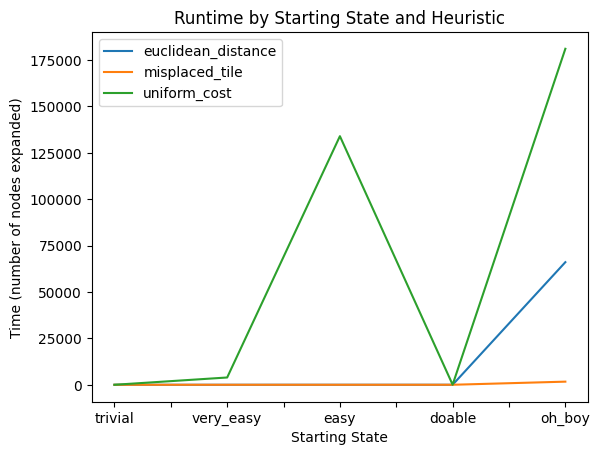

In [4]:
# df.set_index('starting state',)
df.set_index('state').groupby('criteria')['time'].plot(legend=True, xlabel='Starting State', ylabel='Time (number of nodes expanded)', title='Runtime by Starting State and Heuristic')

criteria
euclidean_distance    Axes(0.125,0.11;0.775x0.77)
misplaced_tile        Axes(0.125,0.11;0.775x0.77)
uniform_cost          Axes(0.125,0.11;0.775x0.77)
Name: space, dtype: object

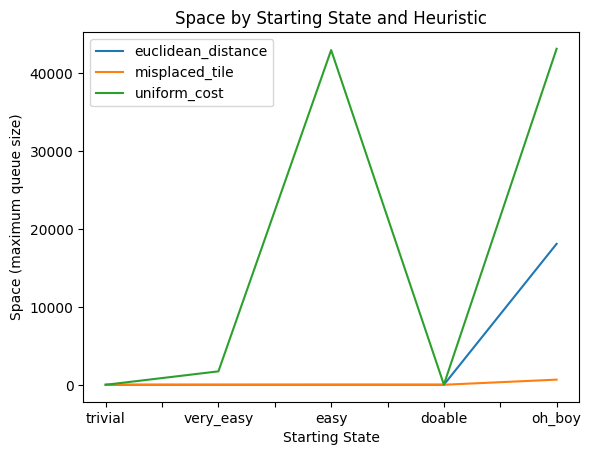

In [5]:
df.set_index('state').groupby('criteria')['space'].plot(legend=True, xlabel='Starting State', ylabel='Space (maximum queue size)', title='Space by Starting State and Heuristic')

criteria
euclidean_distance    Axes(0.125,0.11;0.775x0.77)
misplaced_tile        Axes(0.125,0.11;0.775x0.77)
uniform_cost          Axes(0.125,0.11;0.775x0.77)
Name: time, dtype: object

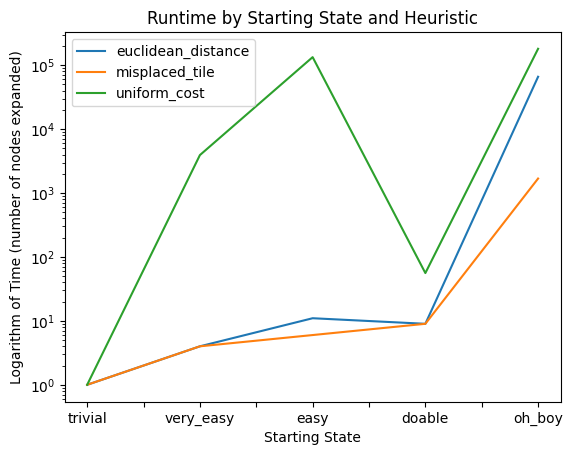

In [6]:
df.set_index('state').groupby('criteria')['time'].plot(legend=True, xlabel='Starting State', ylabel='Logarithm of Time (number of nodes expanded)', title='Runtime by Starting State and Heuristic', logy = True)

criteria
euclidean_distance    Axes(0.125,0.11;0.775x0.77)
misplaced_tile        Axes(0.125,0.11;0.775x0.77)
uniform_cost          Axes(0.125,0.11;0.775x0.77)
Name: space, dtype: object

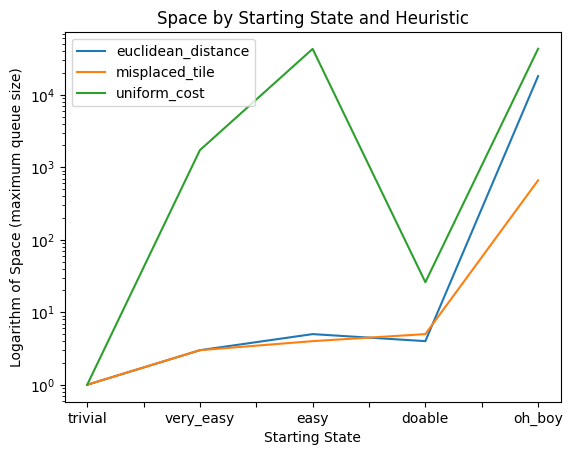

In [7]:
df.set_index('state').groupby('criteria')['space'].plot(legend=True, xlabel='Starting State', ylabel='Logarithm of Space (maximum queue size)', title='Space by Starting State and Heuristic', logy=True)